# TD2: Visualization and Pattern Recognition with time series data

### Exercise 1: Data Loading and Missing Value Detection

Load  the  dataset  and  check  for  any  missing  values,  and  visualize  the  distribution  of  thesemissing values.

In [269]:
import pandas as pd
data = pd.read_csv("weather.csv")

In [270]:
import matplotlib.pyplot as plt
import seaborn as sns
data.isnull().sum()

date              0
precipitation    50
temp_max         70
temp_min         47
wind             52
weather           0
dtype: int64

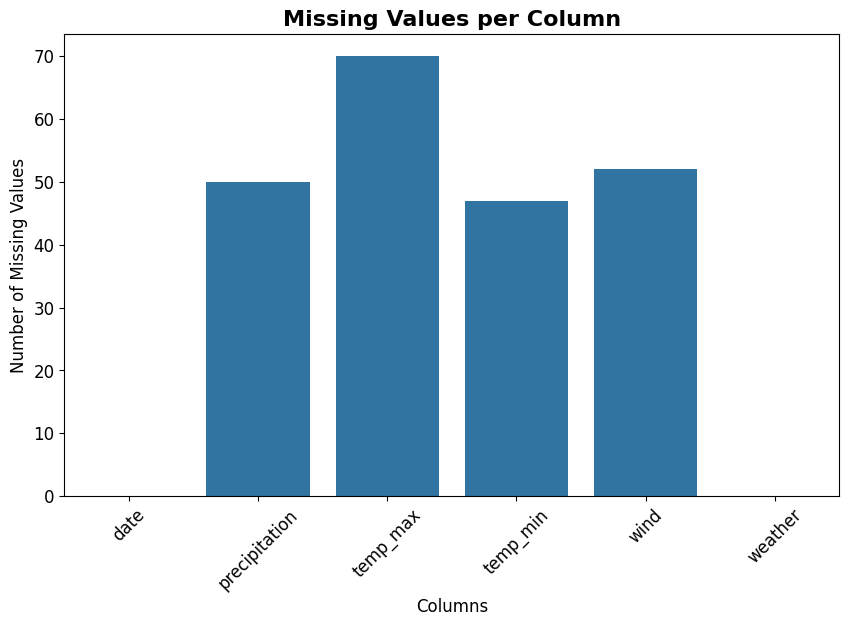

In [271]:
# Calculate the number of missing values in each column
missing_counts = data.isnull().sum()

# Plot missing values
plt.figure(figsize=(10, 6))
sns.barplot(x=missing_counts.index, y=missing_counts.values)

plt.title("Missing Values per Column", fontsize=16, fontweight='bold')
plt.xlabel("Columns", fontsize=12)
plt.ylabel("Number of Missing Values", fontsize=12)
plt.xticks(rotation=45, fontsize=12)
plt.yticks(fontsize=12)

plt.show()

### Exercise 2: Interpolate and Verify Missing Values

Apply linear interpolation to fill the missing values in the dataset. After interpolation, verify that all missing values have been successfully filled. If there are still missing values, suggest and implement additional methods to handle them (e.g., forward fill, backward fill, or using aconstant value). Observe and analyze the results of the imputation.

In [272]:
data['precipitation'] = data['precipitation'].interpolate(method='linear')
data['temp_max'] = data['temp_max'].interpolate(method='linear')
data['temp_min'] = data['temp_min'].interpolate(method='linear')
data['wind'] = data['wind'].interpolate(method='linear')

In [273]:
data.isnull().sum()

date             0
precipitation    0
temp_max         0
temp_min         0
wind             0
weather          0
dtype: int64

### Exercise 3: Add Columns for Quarter and Daily Average Temperature

Add two new columns to the dataset:

1.  A  column  that  assigns  each  row  to  a  quarter  (Q1,  Q2,  Q3,  or  Q4)  based  on  the  datecolumn. Ensure the dates are correctly parsed and categorized.
2.  A column that calculates the daily average temperature, using the available temperaturedata (e.g., maximum and minimum temperatures).Verify the correctness of both new columns.

In [274]:
data["date"] = pd.to_datetime(data["date"])


# Map dates to quarters
data['quarter'] = data['date'].dt.quarter

# Convert to Q1, Q2, Q3, Q4 format
data['quarter'] = data['quarter'].apply(lambda x: f"Q{x}")

data['avgtemp'] = (data['temp_max'] + data['temp_min']) / 2

data.head()

,date,precipitation,temp_max,temp_min,wind,weather,quarter,avgtemp
0,2012-01-01,0.0,12.8,5.0,4.7,drizzle,Q1,8.90
1,2012-01-02,10.9,10.6,2.8,4.5,rain,Q1,6.70
2,2012-01-03,0.8,11.7,7.2,2.3,rain,Q1,9.45
3,2012-01-04,20.3,12.2,5.6,4.7,rain,Q1,8.90
4,2012-01-05,1.3,8.9,2.8,6.1,rain,Q1,5.85


### Exercise 4: Visualizing Temperature Trends for Spring 2012

Filter the dataset to select data for the year 2012 and the Spring season. Then, create a lineplot to visualize the temperature trends during the Spring of 2012. The plot should display:

1.  The maximum temperature (tempmax) in red.
2.  The minimum temperature (tempmin) in blue.
3.  The average temperature (avgtemp) in green.

Ensure that the x-axis represents the dates, and the y-axis shows the temperature values (°C).Add appropriate labels for the title, axes, and legend to make the plot clear and informative.

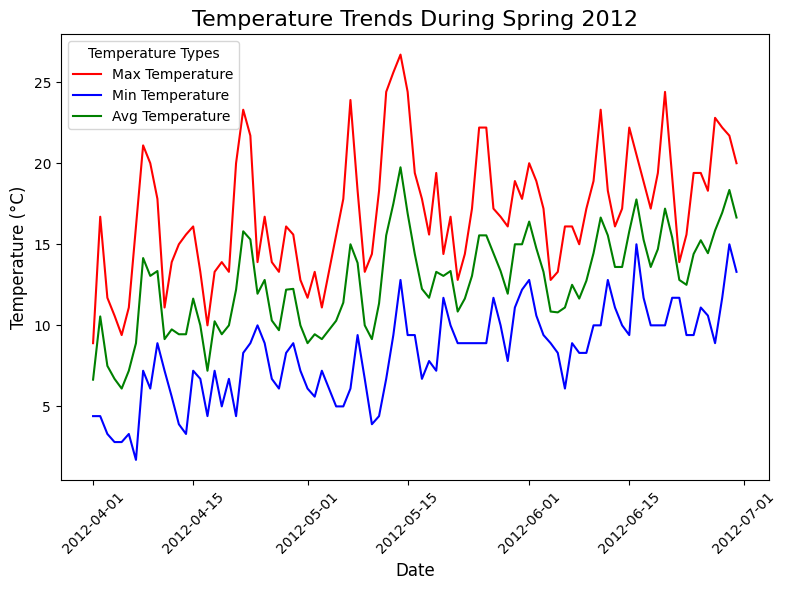

In [275]:
spring_2012 = data[(data['date'].dt.year == 2012) & (data['quarter'] == 'Q2')]

plt.figure(figsize=(8, 6))
# Plot max temperature
plt.plot(spring_2012['date'], spring_2012['temp_max'], color='red', label='Max Temperature')

# Plot min temperature
plt.plot(spring_2012['date'], spring_2012['temp_min'], color='blue', label='Min Temperature')

# Plot average temperature
plt.plot(spring_2012['date'], spring_2012['avgtemp'], color='green', label='Avg Temperature')

# Adding labels, title, and legend
plt.title("Temperature Trends During Spring 2012", fontsize=16)
plt.xlabel("Date", fontsize=12)
plt.ylabel("Temperature (°C)", fontsize=12)
plt.legend(title="Temperature Types", fontsize=10)
plt.xticks(rotation=45)  # Rotate x-axis labels for better readability

# Show plot
plt.tight_layout()
plt.show()

### Exercise 5: Plot Seasonal Average Temperature Variations for 2012

Group the dataset by season and calculate the average values for the maximum temperature (tempmax), minimum temperature (tempmin), and average temperature (avgtemp). Then, reshape the data into a long format suitable for plotting. Create a bar plot that visualizes the seasonal average temperature variations in 2012. The bar chart should display:

1.  The average maximum temperature in each season, represented by a specific color.
2.  The average minimum temperature in each season, represented by a different color.
3.  The average temperature in each season.

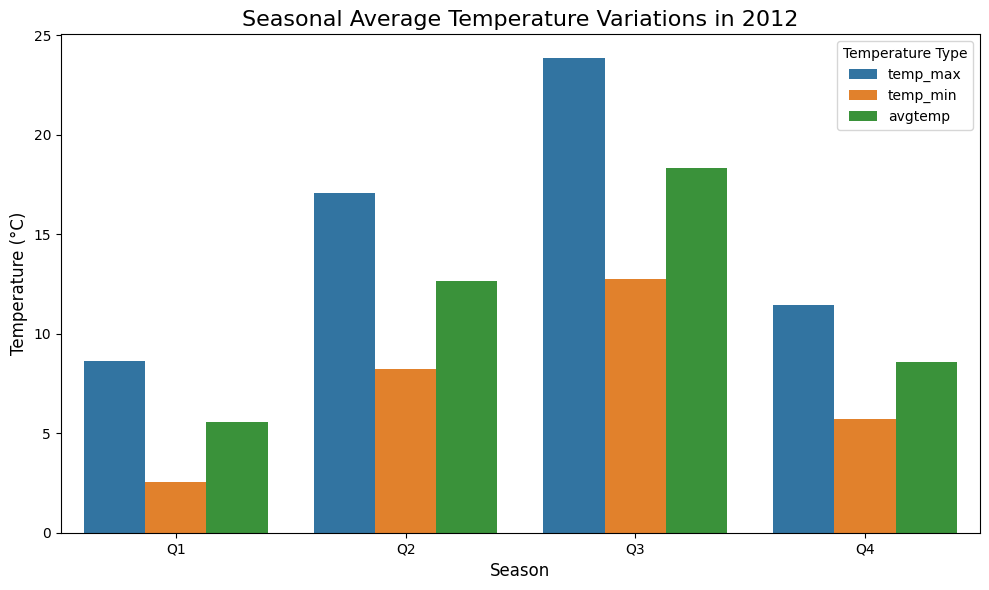

In [276]:
# Filter data for 2012
data_2012 = data[data['date'].dt.year == 2012]

# Group by season and calculate average temperatures
seasonal_avg = data_2012.groupby('quarter')[['temp_max', 'temp_min', 'avgtemp']].mean().reset_index()

# Reshape data into a long format suitable for plotting
seasonal_avg_long = pd.melt(seasonal_avg, id_vars='quarter', 
                            value_vars=['temp_max', 'temp_min', 'avgtemp'], 
                            var_name='Temperature Type', 
                            value_name='Temperature (°C)')

season_order = ['Q1', 'Q2', 'Q3', 'Q4']
seasonal_avg_long['quarter'] = pd.Categorical(seasonal_avg_long['quarter'], categories=season_order, ordered=True)
import seaborn as sns
# Plotting the bar chart
plt.figure(figsize=(10, 6))
sns.barplot(data=seasonal_avg_long, x='quarter', y='Temperature (°C)', hue='Temperature Type', palette='tab10')

# Adding labels, title, and legend
plt.title("Seasonal Average Temperature Variations in 2012", fontsize=16)
plt.xlabel("Season", fontsize=12)
plt.ylabel("Temperature (°C)", fontsize=12)
plt.legend(title="Temperature Type", fontsize=10)

# Show plot
plt.tight_layout()
plt.show()

### Exercise 6: Visualize Weather Type Distribution for Spring 2012

Analyze the distribution of weather types in the Spring of 2012 by counting the occurrences ofeach weather type in the dataset. Create a bar chart using Plotly to visualize the distribution. 

The chart should display:
1.  The weather types on the x-axis.
2.  The count of occurrences for each weather type on the y-axis.
3.  Different colors for each weather type to distinguish them visually.

Ensure the chart includes an appropriate title and axis labels for clarity.

In [277]:
import plotly.express as px
spring_2012 = data[(data['date'].dt.year == 2012) & (data['quarter'] == 'Q2')]

# Count occurrences of each weather type
weather_counts = spring_2012['weather'].value_counts().reset_index()
weather_counts.columns = ['Weather Type', 'Count']

# Create a bar chart using Plotly
px.bar(
    weather_counts,
    x='Weather Type',
    y='Count',
    color='Weather Type',
    title="Weather Type Distribution in Spring 2012",
    labels={'Count': 'Number of Occurrences', 'Weather Type': 'Type of Weather'},
    text='Count'
)

# Display the chart
plt.show()

#### Exercise 7: Calculate and Visualize Monthly Average Temperature

Calculate the monthly average temperature for each month in the year 2012. To do this, group the dataset by month and compute the average of the maximum, minimum, and average temperatures. Then, visualize these monthly averages using a line plot, where each line represents one of the temperature metrics (max, min, average). 

Make sure to label the axes and include a title. Use different colors to distinguish between the temperature types.


/tmp/ipykernel_50026/2563951935.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



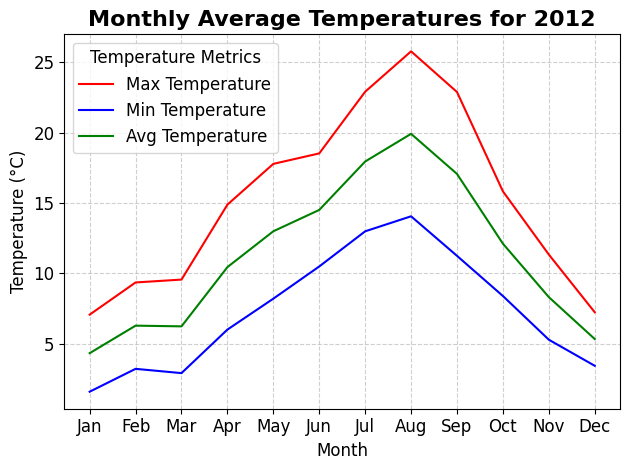

In [278]:

# Filter data for the year 2012
data_2012 = data[data['date'].dt.year == 2012]

data_2012['month'] = data_2012['date'].dt.month

# Group by month and calculate the average temperatures
monthly_avg = data_2012.groupby('month')[['temp_max', 'temp_min', 'avgtemp']].mean().reset_index()

# Plot each temperature metric
sns.lineplot(data=monthly_avg, x='month', y='temp_max', label='Max Temperature', color='red')
sns.lineplot(data=monthly_avg, x='month', y='temp_min', label='Min Temperature', color='blue')
sns.lineplot(data=monthly_avg, x='month', y='avgtemp', label='Avg Temperature', color='green')

# Enhancing the plot
plt.title('Monthly Average Temperatures for 2012', fontsize=16, fontweight='bold')
plt.xlabel('Month', fontsize=12)
plt.ylabel('Temperature (°C)', fontsize=12)
plt.xticks(ticks=range(1, 13), labels=[
    'Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'
], fontsize=12)
plt.yticks(fontsize=12)
plt.legend(title='Temperature Metrics', fontsize=12, title_fontsize=12)
plt.grid(linestyle='--', alpha=0.6)

# Show the plot
plt.tight_layout()
plt.show()


#### Exercise 8: Time Series Decomposition of Average Temperature

Using  an  additive  model,  perform  a  time  series  decomposition  of  the  average  temperature (avgtemp).  The  decomposition  should  account  for  daily  data  with  annual  seasonality.  

The steps are:
1.  Set the date column as the index of the dataset.
2.  Apply the seasonal decompose function to decompose the avgtemp column into its components: trend, seasonal, and residual.
3.  Plot the decomposed components (trend, seasonal, and residual) to visualize the individual patterns.

Ensure  that  the  plot  is  appropriately  formatted  and  the  components  are  clearly  labeled  for easy interpretation.



[notice] A new release of pip is available: 24.2 -> 24.3.1
[notice] To update, run: python3 -m pip install --upgrade pip


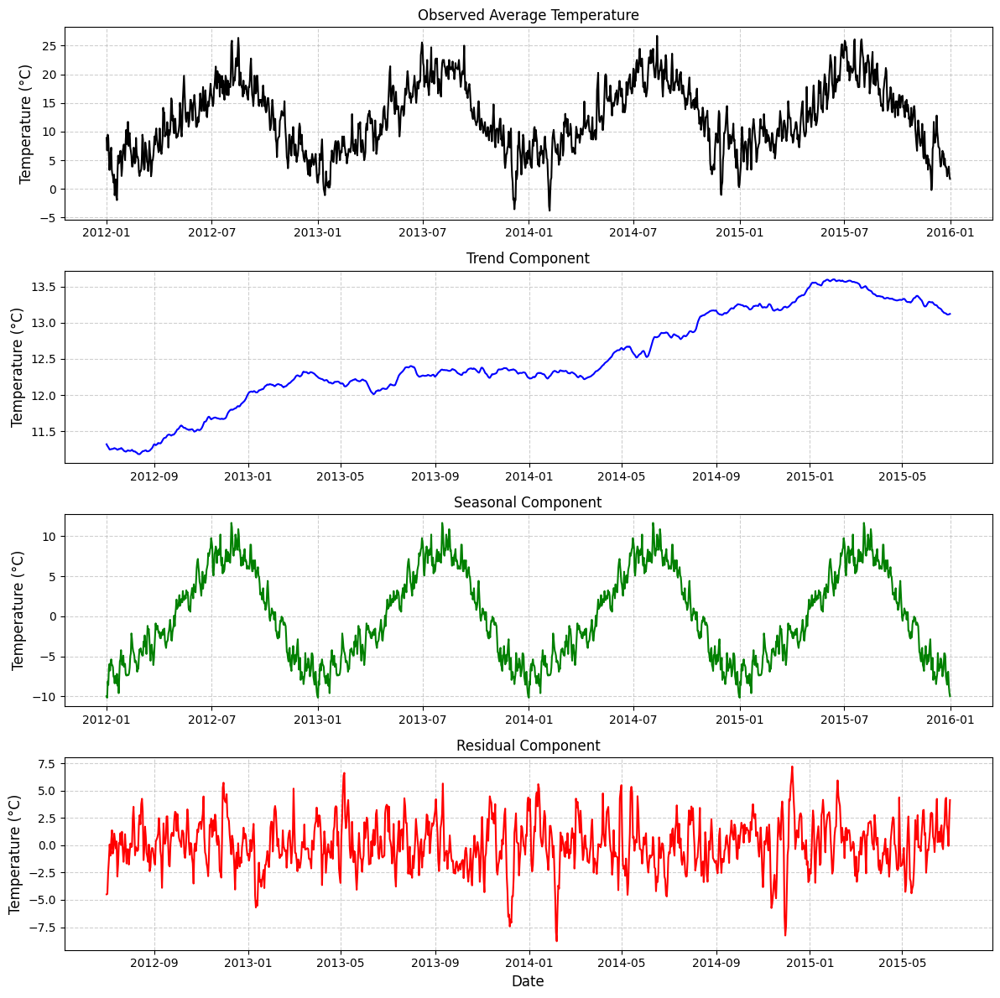

In [279]:
!pip install statsmodels
from statsmodels.tsa.seasonal import seasonal_decompose

# 1. Set the 'date' column as the index
data.set_index('date', inplace=True)

# 2. Perform time series decomposition
# Using daily frequency and annual seasonality
decomposition = seasonal_decompose(data['avgtemp'], model='additive', period=365)

# 3. Plot the decomposed components
plt.figure(figsize=(12, 12))

# Observed
plt.subplot(4, 1, 1)
plt.plot(data.index, decomposition.observed, label='Observed', color='black')
plt.title('Observed Average Temperature', fontsize=12)
plt.ylabel('Temperature (°C)', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.6)

# Trend
plt.subplot(4, 1, 2)
plt.plot(data.index, decomposition.trend, label='Trend', color='blue')
plt.title('Trend Component', fontsize=12)
plt.ylabel('Temperature (°C)', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.6)

# Seasonal
plt.subplot(4, 1, 3)
plt.plot(data.index, decomposition.seasonal, label='Seasonal', color='green')
plt.title('Seasonal Component', fontsize=12)
plt.ylabel('Temperature (°C)', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.6)

# Residual
plt.subplot(4, 1, 4)
plt.plot(data.index, decomposition.resid, label='Residual', color='red')
plt.title('Residual Component', fontsize=12)
plt.ylabel('Temperature (°C)', fontsize=12)
plt.xlabel('Date', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.6)

# Adjust layout and show the plot
plt.tight_layout()
plt.show()

#### Exercise 9: Visualize Daily Precipitation Changes in Seattle for 2012

Plot the daily precipitation data for Seattle in 2012 using a line chart. The chart should show how the precipitation changed day by day throughout the year.


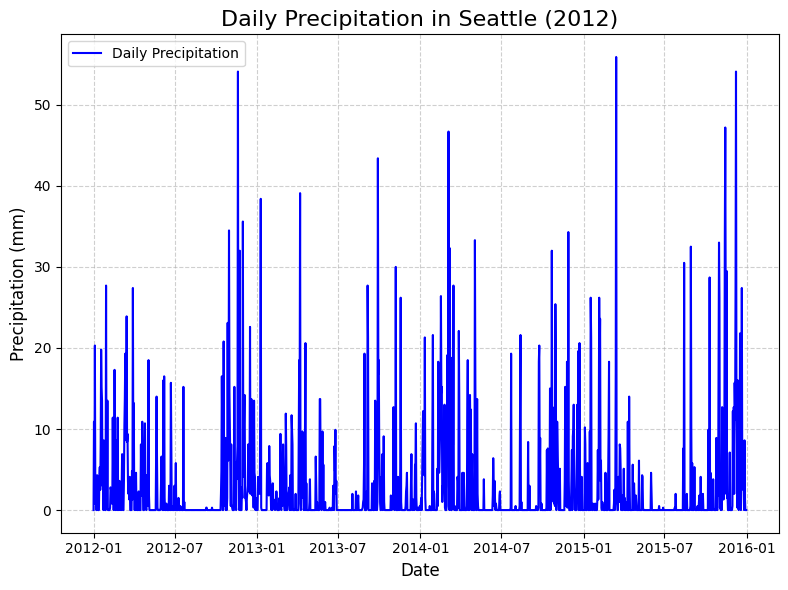

In [280]:
# Plotting the daily precipitation data
plt.figure(figsize=(8, 6))
plt.plot(data.index, data['precipitation'], color='blue', label='Daily Precipitation')

# Adding plot details
plt.title('Daily Precipitation in Seattle (2012)', fontsize=16)
plt.xlabel('Date', fontsize=12)
plt.ylabel('Precipitation (mm)', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.6)
plt.legend()

# Display the plot
plt.tight_layout()
plt.show()


#### Exercise 10: Create an Interactive Choropleth Map of Daily Precipitation Changes in Seattle

Create an interactive choropleth map to visualize daily precipitation changes in Seattle for theyear 2012.

The steps include:
1.  Load a GeoJSON file representing the Seattle city boundaries.
2.  Use Plotly’s choropleth function to plot the precipitation data for each location.
3.  Use the rowID column to match data with the geographical boundaries in the GeoJSONfile.
4.  Set the precipitation column as the color scale, and ensure the color transition is smooth,using a soft blue gradient.
5.  Use the animation frame argument to animate the map by date, showing how precipitation changes over time.
6.  Customize the map’s borders, background, and other visual elements for a clean, readable presentation.

Ensure the map has a title and color bar that indicates the range of precipitation values. Thefinal map should be interactive and clearly show how precipitation varies across Seattle overthe course of 2012.


In [281]:
import plotly.express as px
import json
import numpy as np
# Step 1: Load the GeoJSON file representing Seattle's boundaries
with open('2016_seattle_city.geojson') as f:
    geojson = json.load(f)
# Step 3: Create the interactive choropleth map using Plotly
data['rowID'] = 1
data.reset_index(inplace = True)

# Create a choropleth map
fig = px.choropleth(
    data,
    geojson=geojson,
    locations='rowID', # The rowlD column in your data 
    featureidkey='properties.rowID', # Corresponding rowID in GeoJSON 
    color='precipitation', 
    animation_frame='date',
    range_color=(0, 54), # Adjust according to the precipitation data range 
    title='2012 Daily Precipitation Changes in Seattle', # English title 
    color_continuous_scale=["#f7fbff", "#deebf7", "#c6dbef", "#9ecae1", "#6baed6", "#4292c6" ,"#2171b5", "#084594"] #
)
# Update the layout to make the map more readable
fig.update_geos(
    visible=True,
    showcoastlines=True,
    coastlinecolor="Black",
    projection_type="mercator",
    showframe=False,
    fitbounds ="locations",
)

# Set a title for the map
fig.update_layout(
    title_text='Daily Precipitation in Seattle (2012)',
    geo=dict(
        center={"lat": 47.6062, "lon": -122.3321},  # Center map on Seattle
        projection_type="mercator"
    )
)

# Show the plot
fig.show()


#### Exercise 11: Pattern Recognition in Seattle Weather Data (Bonus)

**Objective**: Identify and classify distinct weather patterns over time using the available weather data.

**Description**:
1.  Preprocess  the  Data:  Ensure  that  the  dataset  is  cleaned,  with  missing  values  handled appropriately.
2.  Extract features related to weather patterns, such as daily maximum temperature, minimum temperature, average temperature, and precipitation. Identify Patterns:
3.  Use  unsupervised  learning  techniques  like  clustering  (e.g.,  K-means  clustering  or  DBSCAN) to group days with similar weather patterns based on temperature and precipitation data. Optionally, explore dimensionality reduction methods (e.g., PCA) to visualize the clusters in a 2D space. Visualize the Patterns:
4.  Visualize the identified clusters using scatter plots or time series plots to show how distinct weather  patterns  evolve  over  time.  Use  color  coding  or  different  markers  to  distinguish between the identified weather patterns. Analyze and Interpret:
5.  Analyze  the  characteristics  of  each  identified  weather  pattern.  For  example,  you  might discover patterns representing hot and dry days, cold and rainy days, or moderate weather.Discuss how these patterns might relate to real-world phenomena, such as seasonal weather changes or extreme weather events.

**Expected Output**:

* A  visualization  of  weather  patterns  clustered  into  distinct  groups,  with  analysis  of  the characteristics of each group.
* A brief report interpreting the identified weather patterns, including any trends or insights. 

This exercise focuses on applying machine learning techniques to identify patterns in weather data, which is a key aspect of pattern recognition in real-world datasets.

In [282]:
df = data.copy()

In [283]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans, DBSCAN
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import seaborn as sns

# Step 1: Data Preparation
# Select relevant features
features = ['temp_max', 'temp_min', 'avgtemp','precipitation']
df = df[features]
df.head()

,temp_max,temp_min,avgtemp,precipitation
0,12.8,5.0,8.90,0.0
1,10.6,2.8,6.70,10.9
2,11.7,7.2,9.45,0.8
3,12.2,5.6,8.90,20.3
4,8.9,2.8,5.85,1.3


In [284]:

# Normalize the data
scaler = StandardScaler()
scaled_data = scaler.fit_transform(df)

# Step 2: Clustering
# Apply K-Means Clustering
kmeans = KMeans(n_clusters=3, random_state=42)  # You can adjust the number of clusters
clusters = kmeans.fit_predict(scaled_data)

# Add the cluster labels to the DataFrame
df['Cluster'] = clusters

# Step 3: Dimensionality Reduction
# Apply PCA for 2D visualization
pca = PCA(n_components=2)
reduced_data = pca.fit_transform(scaled_data)

# Add PCA results to the DataFrame
df['PCA1'] = reduced_data[:, 0]
df['PCA2'] = reduced_data[:, 1]
df['date'] = data["date"]
df['quarter'] = data["quarter"]
df['weather'] = data["weather"]


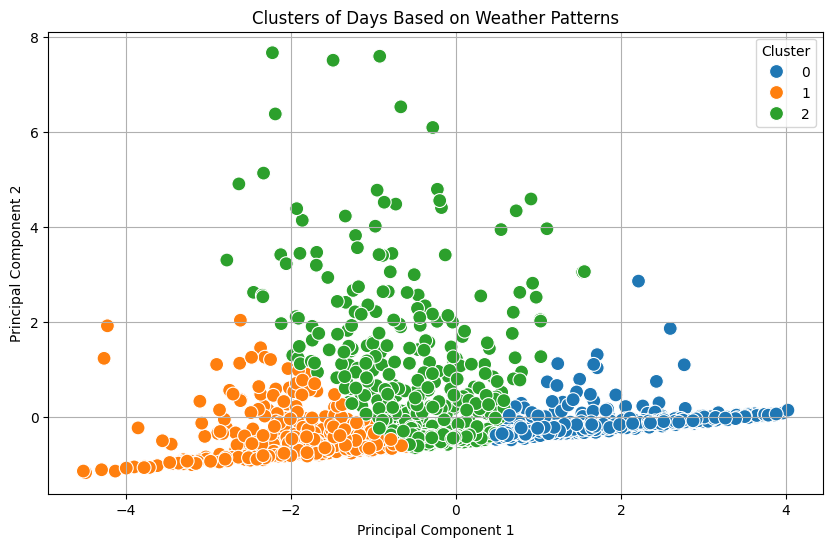

In [285]:

# Step 4: Visualization
# Scatter plot of clusters
plt.figure(figsize=(10, 6))
sns.scatterplot(x='PCA1', y='PCA2', hue='Cluster', palette="tab10",data=df, s=100)
plt.title('Clusters of Days Based on Weather Patterns')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.legend(title='Cluster')
plt.grid(True)
plt.show()

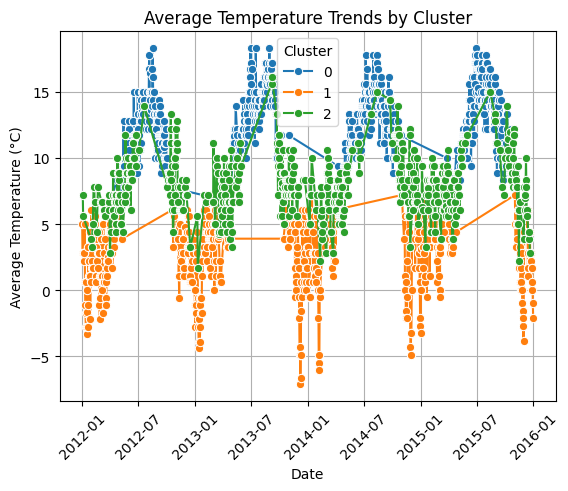

In [286]:
# Temperature trends
sns.lineplot(x='date', y='temp_min', hue='Cluster', data=df, palette='tab10', marker='o')
plt.title('Average Temperature Trends by Cluster')
plt.xlabel('Date')
plt.xticks(rotation=45)  
plt.ylabel('Average Temperature (°C)')
plt.legend(title='Cluster')
plt.grid(True)
plt.show()

In [287]:
# Analyze cluster characteristics
cluster_summary = df.groupby('Cluster')[['temp_max', 'temp_min', 'avgtemp', 'precipitation']].mean()
print(cluster_summary)


# Add seasonal distribution for further insight
season_cluster_distribution = df.groupby(['Cluster', 'quarter']).size().unstack()
print(season_cluster_distribution)


# Add seasonal distribution for further insight
weather_cluster_distribution = df.groupby(['Cluster', 'weather']).size().unstack()
print(weather_cluster_distribution)

          temp_max   temp_min    avgtemp  precipitation
Cluster                                                
0        24.031217  12.983245  18.507231       0.362787
1         8.756613   2.378886   5.567749       1.786891
2        14.244276   7.917603  11.080940       7.488553
quarter     Q1     Q2     Q3     Q4
Cluster                            
0          1.0  185.0  344.0   37.0
1        240.0   29.0    NaN  162.0
2        120.0  150.0   24.0  169.0
weather  drizzle   fog   rain  snow    sun
Cluster                                   
0           25.0  43.0  104.0   NaN  395.0
1           23.0  38.0  198.0  24.0  148.0
2            5.0  20.0  339.0   2.0   97.0


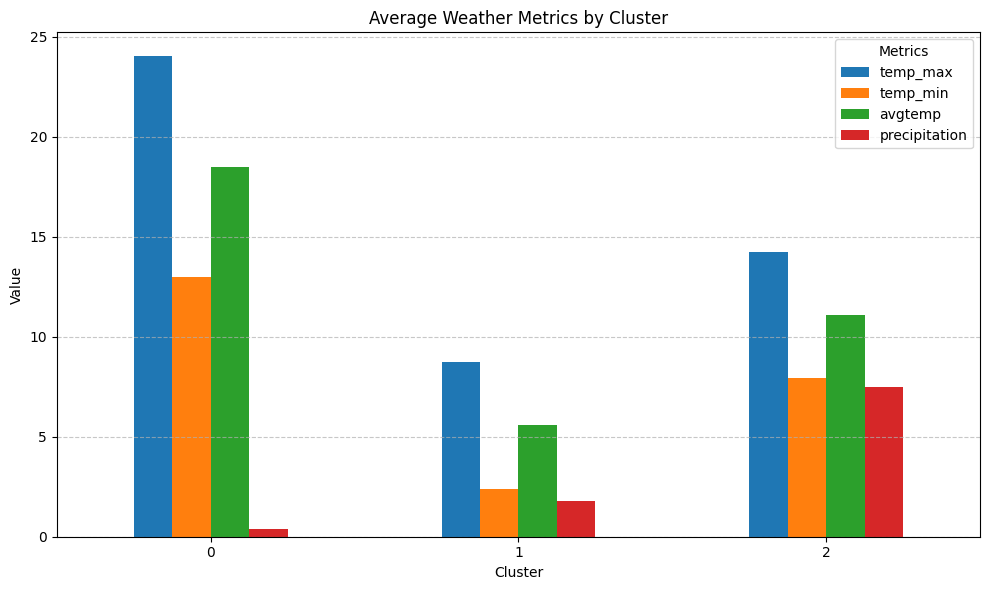

In [288]:

# Bar plot of weather metrics by cluster
cluster_summary.plot(kind='bar', figsize=(10, 6))
plt.title("Average Weather Metrics by Cluster")
plt.ylabel("Value")
plt.xlabel("Cluster")
plt.xticks(rotation=0)
plt.legend(title="Metrics")
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

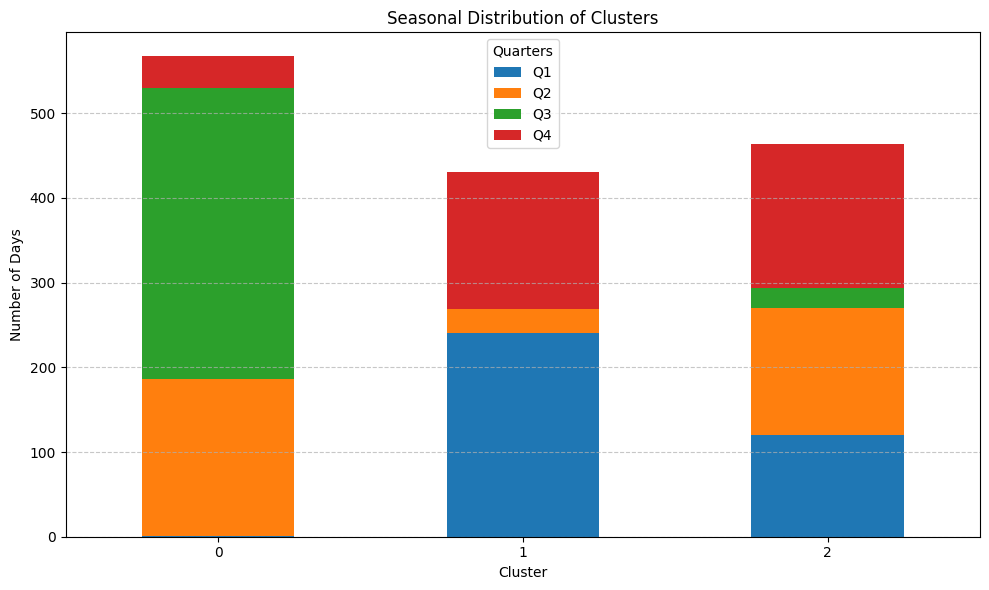

In [289]:
season_cluster_distribution = season_cluster_distribution.fillna(0)

# Stacked bar plot
season_cluster_distribution.plot(kind='bar', stacked=True, figsize=(10, 6))
plt.title("Seasonal Distribution of Clusters")
plt.ylabel("Number of Days")
plt.xlabel("Cluster")
plt.xticks(rotation=0)
plt.legend(title="Quarters")
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

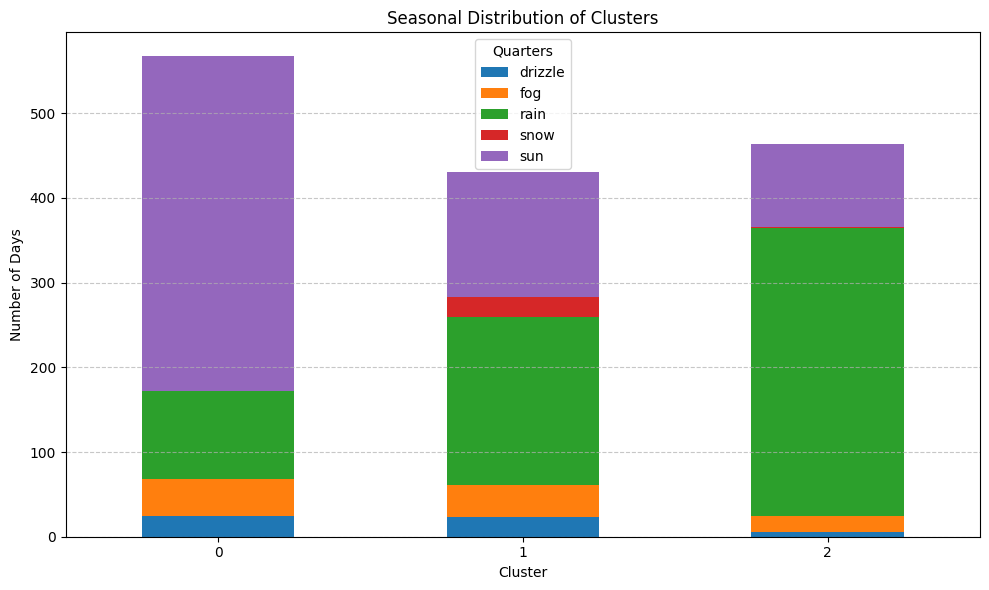

In [290]:
weather_cluster_distribution = weather_cluster_distribution.fillna(0)

# Stacked bar plot
weather_cluster_distribution.plot(kind='bar', stacked=True, figsize=(10, 6))
plt.title("Seasonal Distribution of Clusters")
plt.ylabel("Number of Days")
plt.xlabel("Cluster")
plt.xticks(rotation=0)
plt.legend(title="Quarters")
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()

The analysis reveals three distinct weather patterns or clusters. Cluster 0, is characterized by warm and moderately wet conditions, had an average maximum temperature of 24°C, a minimum temperature of 13°C, and moderate precipitation of 0.36 mm. This cluster predominantly occurrs in summer (Q2) and autumn (Q3). Cluster 1, defined by cold and wet conditions, exhibited an average maximum temperature of 8.8°C, a minimum of 2.4°C, and the highest precipitation levels at 1.79 mm. It was most frequent during winter (Q1) and autumn (Q4). Cluster 2, representing mild and very wet conditions, showed an average maximum temperature of 14.2°C, a minimum of 7.9°C, and heavy precipitation at 7.49 mm. This cluster was evenly distributed across spring (Q2), autumn (Q3), and winter (Q4).
